# DeepLabCut Toolbox - demo for post processing

https://github.com/AlexEMG/DeepLabCut

In [1]:
# Importing the toolbox (takes several seconds)
import pandas as pd
from pathlib import Path
import numpy as np
import os
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'svg'

Bad val 'qt5' on line #1
	"backend: qt5
"
	in file "/Users/hunglo/.matplotlib/matplotlibrc"
	Key backend: Unrecognized backend string 'qt5': valid strings are ['GTK3Agg', 'GTK3Cairo', 'MacOSX', 'nbAgg', 'Qt4Agg', 'Qt4Cairo', 'Qt5Agg', 'Qt5Cairo', 'TkAgg', 'TkCairo', 'WebAgg', 'WX', 'WXAgg', 'WXCairo', 'agg', 'cairo', 'pdf', 'pgf', 'ps', 'svg', 'template']


In [2]:
# One example video from Hung's
#video='DSC7674200224.wmv'
#DLCscorer='DLC_resnet50_SatiationOct16shuffle1_160000'

#dataname = str(Path(video).stem) + DLCscorer + '.h5'

# ----------- ^^^ will change them later --------------

# #loading output of DLC
# Dataframe = pd.DataFrame()
# Dataframe = pd.read_hdf('/Users/hunglo/Desktop/DSC7674200224DLC_resnet50_SatiationOct16shuffle1_160000.h5')

# Now change this to .csv file for a better consistency for Natalie and Daniel
#filename = '/Users/hunglo/Desktop/DSC7674200224DLC_resnet50_SatiationOct16shuffle1_160000.csv'
filename = '/Users/hunglo/Desktop/20180903_Schmitz_PaS_B1_C1_NL_Day1_NOVEL_DSC001663DLC_resnet50_NOVEL_VIDEONov7shuffle1_100000filtered.csv'
#filename_short = filename.split('/')[-1][0:13]
filename_short = 'DSC001663_20180903'

Dataframe = pd.DataFrame()
Dataframe = pd.read_csv(filename,skiprows=2)
#    '/Users/hunglo/Desktop/DSC7674200224DLC_resnet50_SatiationOct16shuffle1_160000.csv',skiprows=2)

LabelNames_temp = pd.read_csv(filename,nrows=1)
#    '/Users/hunglo/Desktop/DSC7674200224DLC_resnet50_SatiationOct16shuffle1_160000.csv',nrows=1)
Label_bpts = list(LabelNames_temp.iloc[0][LabelNames_temp.columns[:]].values)

Dataframe.head()

,coords,x,y,likelihood,x.1,y.1,likelihood.1,x.2,y.2,likelihood.2,x.3,y.3,likelihood.3,x.4,y.4,likelihood.4,x.5,y.5,likelihood.5
0,0,138.720078,390.167023,0.999996,150.511734,388.653534,0.999995,128.041229,372.264954,0.999999,154.364182,441.994690,1.0,461.210510,423.885590,0.998699,226.047104,132.121994,0.969426
1,1,141.658051,390.167023,1.000000,154.403198,388.653534,0.999999,145.166565,372.264954,1.000000,154.364182,441.994690,1.0,461.227448,425.360962,0.998715,226.473618,132.121994,0.988309
2,2,141.660660,390.167023,1.000000,154.456345,388.653534,0.999999,145.166611,372.264954,1.000000,154.364182,441.994690,1.0,461.251038,425.360962,0.998732,226.488693,132.121994,0.987251
3,3,142.755020,387.627594,1.000000,156.251221,387.183716,1.000000,146.422745,369.936218,1.000000,152.108276,440.042084,1.0,461.772308,425.695007,0.999399,226.488693,131.723053,0.997513
4,4,148.919388,378.458038,1.000000,162.219284,384.062866,1.000000,162.444580,364.427673,0.999999,149.882721,435.139404,1.0,461.879181,425.444031,0.999272,226.473618,131.590302,0.994470


In [3]:
# Relabel columns in dataframe
for name in Dataframe.columns:
    Dataframe.rename(columns={name:Label_bpts[Dataframe.columns.get_loc(name)]+'_'+name.split('.')[0]}, inplace=True)
Dataframe.head()

,bodyparts_coords,leftear_x,leftear_y,leftear_likelihood,rightear_x,rightear_y,rightear_likelihood,nose_x,nose_y,nose_likelihood,tailbase_x,tailbase_y,tailbase_likelihood,object1_x,object1_y,object1_likelihood,object2_x,object2_y,object2_likelihood
0,0,138.720078,390.167023,0.999996,150.511734,388.653534,0.999995,128.041229,372.264954,0.999999,154.364182,441.994690,1.0,461.210510,423.885590,0.998699,226.047104,132.121994,0.969426
1,1,141.658051,390.167023,1.000000,154.403198,388.653534,0.999999,145.166565,372.264954,1.000000,154.364182,441.994690,1.0,461.227448,425.360962,0.998715,226.473618,132.121994,0.988309
2,2,141.660660,390.167023,1.000000,154.456345,388.653534,0.999999,145.166611,372.264954,1.000000,154.364182,441.994690,1.0,461.251038,425.360962,0.998732,226.488693,132.121994,0.987251
3,3,142.755020,387.627594,1.000000,156.251221,387.183716,1.000000,146.422745,369.936218,1.000000,152.108276,440.042084,1.0,461.772308,425.695007,0.999399,226.488693,131.723053,0.997513
4,4,148.919388,378.458038,1.000000,162.219284,384.062866,1.000000,162.444580,364.427673,0.999999,149.882721,435.139404,1.0,461.879181,425.444031,0.999272,226.473618,131.590302,0.994470


In [4]:
#Let's have a look at the data:

#these structures are awesome to manipulate, how -->> see pandas https://pandas.pydata.org/pandas-docs/stable/index.html
# Dataframe.head()

In [5]:
# The plotting functions below are put here for simplicity and so that the user can edit them. Note that they 
# (or variants thereof) are in fact in standard DLC and accessible via:

# import deeplabcut
# deeplabcut.utils.plotting.PlottingResults?

In [6]:
# def get_cmap(n, name='hsv'):
#     return plt.cm.get_cmap(name, n)

# def Histogram(vector,color,bins):
#     dvector=np.diff(vector)
#     dvector=dvector[np.isfinite(dvector)]
#     plt.hist(dvector,color=color,histtype='step',bins=bins)

# def PlottingResults(Dataframe,bodyparts2plot,alphavalue=.2,pcutoff=.5,colormap='jet',fs=(4,3)):
#     ''' Plots poses vs time; pose x vs pose y; histogram of differences and likelihoods.'''
#     plt.figure(figsize=fs)
#     colors = get_cmap(len(bodyparts2plot),name = colormap)
#     scorer=Dataframe.columns.get_level_values(0)[0] #you can read out the header to get the scorer name!

#     for bpindex, bp in enumerate(bodyparts2plot):
#         Index=Dataframe[scorer][bp]['likelihood'].values > pcutoff
#         plt.plot(Dataframe[scorer][bp]['x'].values[Index],Dataframe[scorer][bp]['y'].values[Index],'.',color=colors(bpindex),alpha=alphavalue)

#     plt.gca().invert_yaxis()

#     sm = plt.cm.ScalarMappable(cmap=plt.get_cmap(colormap), norm=plt.Normalize(vmin=0, vmax=len(bodyparts2plot)-1))
#     sm._A = []
#     cbar = plt.colorbar(sm,ticks=range(len(bodyparts2plot)))
#     cbar.set_ticklabels(bodyparts2plot)
#     #plt.savefig(os.path.join(tmpfolder,"trajectory"+suffix))
#     plt.figure(figsize=fs)
#     Time=np.arange(np.size(Dataframe[scorer][bodyparts2plot[0]]['x'].values))

#     for bpindex, bp in enumerate(bodyparts2plot):
#         Index=Dataframe[scorer][bp]['likelihood'].values > pcutoff
#         plt.plot(Time[Index],Dataframe[scorer][bp]['x'].values[Index],'--',color=colors(bpindex),alpha=alphavalue)
#         plt.plot(Time[Index],Dataframe[scorer][bp]['y'].values[Index],'-',color=colors(bpindex),alpha=alphavalue)

#     sm = plt.cm.ScalarMappable(cmap=plt.get_cmap(colormap), norm=plt.Normalize(vmin=0, vmax=len(bodyparts2plot)-1))
#     sm._A = []
#     cbar = plt.colorbar(sm,ticks=range(len(bodyparts2plot)))
#     cbar.set_ticklabels(bodyparts2plot)
#     plt.xlabel('Frame index')
#     plt.ylabel('X and y-position in pixels')
#     #plt.savefig(os.path.join(tmpfolder,"plot"+suffix))

#     plt.figure(figsize=fs)
#     for bpindex, bp in enumerate(bodyparts2plot):
#         Index=Dataframe[scorer][bp]['likelihood'].values > pcutoff
#         plt.plot(Time,Dataframe[scorer][bp]['likelihood'].values,'-',color=colors(bpindex),alpha=alphavalue)

#     sm = plt.cm.ScalarMappable(cmap=plt.get_cmap(colormap), norm=plt.Normalize(vmin=0, vmax=len(bodyparts2plot)-1))
#     sm._A = []
#     cbar = plt.colorbar(sm,ticks=range(len(bodyparts2plot)))
#     cbar.set_ticklabels(bodyparts2plot)
#     plt.xlabel('Frame index')
#     plt.ylabel('likelihood')

#     #plt.savefig(os.path.join(tmpfolder,"plot-likelihood"+suffix))

#     plt.figure(figsize=fs)
#     bins=np.linspace(0,np.amax(Dataframe.max()),100)

#     for bpindex, bp in enumerate(bodyparts2plot):
#         Index=Dataframe[scorer][bp]['likelihood'].values < pcutoff
#         X=Dataframe[scorer][bp]['x'].values
#         X[Index]=np.nan
#         Histogram(X,colors(bpindex),bins)
#         Y=Dataframe[scorer][bp]['x'].values
#         Y[Index]=np.nan
#         Histogram(Y,colors(bpindex),bins)

#     sm = plt.cm.ScalarMappable(cmap=plt.get_cmap(colormap), norm=plt.Normalize(vmin=0, vmax=len(bodyparts2plot)-1))
#     sm._A = []
#     cbar = plt.colorbar(sm,ticks=range(len(bodyparts2plot)))
#     cbar.set_ticklabels(bodyparts2plot)
#     plt.ylabel('Count')
#     plt.xlabel('DeltaX and DeltaY')
    
#     #plt.savefig(os.path.join(tmpfolder,"hist"+suffix))

In [7]:
# bodyparts=Dataframe.columns.get_level_values(1) #you can read out the header to get body part names!

# bodyparts2plot=bodyparts #you could also take a subset, i.e. =['snout']

# %matplotlib notebook
# PlottingResults(Dataframe,bodyparts2plot,alphavalue=.2,pcutoff=.5,fs=(8,4))

# # These plots can are interactive and can be customized (see https://matplotlib.org/) [in the code above]
# # note that the snout and other bpts jitter in this example that was not trained for long.

## Great so let's use Federico's code for ROI analysis

Functions to extract time spent by the mouse in each of a list of user defined ROIS!

https://github.com/AlexEMG/DLCutils/blob/master/time_in_each_roi.py

In [8]:
# First, select a bodypart that you want to work with.
bodyparts_list = Label_bpts[1:-1:3]
bodyparts_list

['leftear', 'rightear', 'nose', 'tailbase', 'object1', 'object2']

In [9]:
import time_in_each_roi #the function needs to be in the same folder as the notebook

#let's calculate velocity of the snount

bpt=bodyparts_list[2]
vel = time_in_each_roi.calc_distance_between_points_in_a_vector_2d(np.vstack([Dataframe[bpt+'_x'].values.flatten(), 
                                                                              Dataframe[bpt+'_y'].values.flatten()]).T)

fps=24/3 # frame rate of camera in those experiments
time=np.arange(len(vel))*1./fps
vel=vel*fps #notice the units of vel are relative pixel distance [per time step]

# ---------------comment out--------------------
# # store in other variables:
# xsnout=Dataframe[DLCscorer][bpt]['x'].values
# ysnout=Dataframe[DLCscorer][bpt]['y'].values
# vsnout=vel

# ----------------modified by Hung---------
# Create variable names, or just different columns in a new dataframe?:
Dataframe_ROI = pd.DataFrame()
Dataframe_ROI[bpt+'x']=Dataframe[bpt+'_x'].values
Dataframe_ROI[bpt+'y']=Dataframe[bpt+'_y'].values
Dataframe_ROI[bpt+'v']=vel

Dataframe_ROI.head()

,nosex,nosey,nosev
0,128.041229,372.264954,0.000000
1,145.166565,372.264954,137.002686
2,145.166611,372.264954,0.000366
3,146.422745,369.936218,21.167342
4,162.444580,364.427673,135.538812


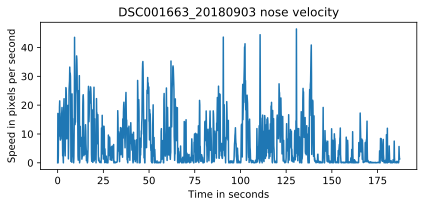

In [10]:
#%matplotlib notebook
plt.figure(figsize=(6,3))
plt.plot(time,Dataframe_ROI[bpt+'v']*1./fps)
plt.title(filename_short+' '+bpt+' velocity')
plt.xlabel('Time in seconds')
plt.ylabel('Speed in pixels per second')
plt.tight_layout()
plt.show()

In [11]:
#define bounding boxes (here for left and right side of treadmill, displayed below)
from collections import namedtuple
position = namedtuple('position', ['topleft', 'bottomright'])
#bp_tracking = np.array((xsnout, ysnout, vsnout))
bp_tracking = np.array((Dataframe_ROI[bpt+'x'], Dataframe_ROI[bpt+'y'], Dataframe_ROI[bpt+'v']))

#two points defining each roi: topleft(X,Y) and bottomright(X,Y).
rois = {'leftside': position((175, 170), (300, 460)),'rightside': position((300, 170), (740, 460))} 
print(rois)
# Check this again since the y axis is usually flipped in DLC data/plt.plot()

{'leftside': position(topleft=(175, 170), bottomright=(300, 460)), 'rightside': position(topleft=(300, 170), bottomright=(740, 460))}


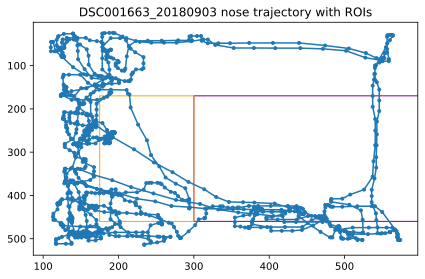

In [12]:
import matplotlib.patches as patches
fig,ax = plt.subplots(1)

#plot snout + bounding boxes for rois
plt.plot(Dataframe_ROI[bpt+'x'],Dataframe_ROI[bpt+'y'],'.-')
plt.title(filename_short+' '+bpt+' trajectory with ROIs')
rect = patches.Rectangle(rois['rightside'].topleft,rois['rightside'].bottomright[0]-rois['rightside'].topleft[0],rois['rightside'].bottomright[1]-rois['rightside'].topleft[1],linewidth=1,edgecolor='purple',facecolor='none')
ax.add_patch(rect)
rect = patches.Rectangle(rois['leftside'].topleft,rois['leftside'].bottomright[0]-rois['leftside'].topleft[0],rois['leftside'].bottomright[1]-rois['leftside'].topleft[1],linewidth=1,edgecolor='orange',facecolor='none')
ax.add_patch(rect)
#plt.xlim(150,760)
#plt.ylim(150,491)
plt.gca().invert_yaxis() # Just to align the plot with real camera settings
plt.tight_layout()
plt.show()

In [14]:
import time_in_each_roi #the function needs to be in the same folder as the notebook

res = time_in_each_roi.get_timeinrois_stats(bp_tracking.T, rois, fps=25/3, check_inroi=True)

#print results:
res

{'transitions_per_roi': {'none': 21,
  'rightside': 9,
  'leftside': 12,
  'tot': 42},
 'cumulative_time_in_roi': {'leftside': 276,
  'rightside': 137,
  'none': 1085,
  'tot': 1498},
 'cumulative_time_in_roi_sec': {'leftside': 33.12,
  'rightside': 16.439999999999998,
  'none': 130.2,
  'tot': 179.76},
 'avg_time_in_roi': {'none': 13.142857142857142,
  'rightside': 15.222222222222221,
  'leftside': 90.41666666666667,
  'tot': 118.78174603174604},
 'avg_time_in_roi_sec': {'none': 1.577142857142857,
  'rightside': 1.8266666666666664,
  'leftside': 10.85,
  'tot': 14.253809523809522},
 'avg_vel_in_roi': {'leftside': 43.07135191339748,
  'rightside': 85.5120890001023,
  'none': 53.00740527778862,
  'tot': 181.5908461912884}}

In [15]:
# Now, plot the scatter plot with density
# libraries
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import kde

# create data
#x = np.random.normal(size=500)
#y = x * 3 + np.random.normal(size=500)

x = Dataframe_ROI[bpt+'x']
y = Dataframe_ROI[bpt+'y']

# Evaluate a gaussian kde on a regular grid of nbins x nbins over data extents
nbins=300
k = kde.gaussian_kde([x,y])
xi, yi = np.mgrid[x.min():x.max():nbins*1j, y.min():y.max():nbins*1j]
zi = k(np.vstack([xi.flatten(), yi.flatten()]))

In [16]:
fig,ax = plt.subplots(figsize=(7,4))

# Make the plot
_ = ax.pcolormesh(xi, yi, zi.reshape(xi.shape),cmap='viridis')
cbar = fig.colorbar(_, ax=ax)
cbar.set_ticks([])

plt.gca().invert_yaxis() # Just to align the plot with real camera settings
plt.title(filename_short+' '+bpt+' density plot')
plt.show()


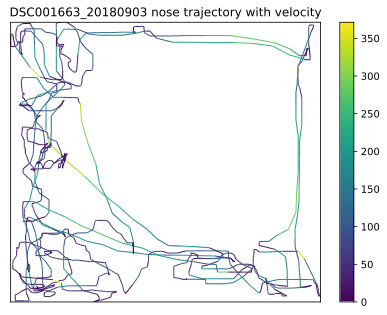

In [17]:
# Now let's plot the trajectory with velocity (color coding)

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import ListedColormap, BoundaryNorm

x = Dataframe_ROI[bpt+'x']
y = Dataframe_ROI[bpt+'y']
v = Dataframe_ROI[bpt+'v']

# Create a set of line segments so that we can color them individually
# This creates the points as a N x 1 x 2 array so that we can stack points
# together easily to get the segments. The segments array for line collection
# needs to be (numlines) x (points per line) x 2 (for x and y)
points = np.array([x, y]).T.reshape(-1, 1, 2)
segments = np.concatenate([points[:-1], points[1:]], axis=1)

# Plotting
fig, ax = plt.subplots(figsize=(6,4.5))

# Create a continuous norm to map from data points to colors
norm = plt.Normalize(v.min(), v.max())
#norm = plt.Normalize(v.min(), 15)
lc = LineCollection(segments, cmap='viridis', norm=norm)
# Set the values used for colormapping
lc.set_array(v)
lc.set_linewidth(1)
line = ax.add_collection(lc)
fig.colorbar(line, ax=ax)

# Setting lim here is important, otherwise can't show fig properly
ax.set_xlim(x.min(), x.max())
ax.set_ylim(y.min(), y.max())
ax.get_yaxis().set_visible(False)
ax.get_xaxis().set_visible(False)

#plt.xlim(150,760)
#plt.ylim(150,491)

plt.gca().invert_yaxis() # Just to align the plot with real camera settings
plt.title(filename_short+' '+bpt+' trajectory with velocity')
plt.tight_layout()
plt.show()

In [18]:
# With the upper figure, I think it's important that we need to remove uncertian points from DLC data.
# Ideally I should remove points that have <0.95 likelihood, and interpolate.
# Definitely can find something from NumPy or SciPy, but for some other time.